# Visualiization GAN loss | Output History

In [1]:
import matplotlib.pyplot as plt
import matplotlib.animation as animation
import h5py
import numpy as np
import torch

from IPython.display import HTML

## Load log file

In [2]:
hf = h5py.File('./output/logs.h5', 'r')

In [3]:
hf.keys()

<KeysViewHDF5 ['D_losses', 'G_losses']>

In [4]:
D_losses = np.array(hf.get('D_losses'))
G_losses = np.array(hf.get('G_losses'))

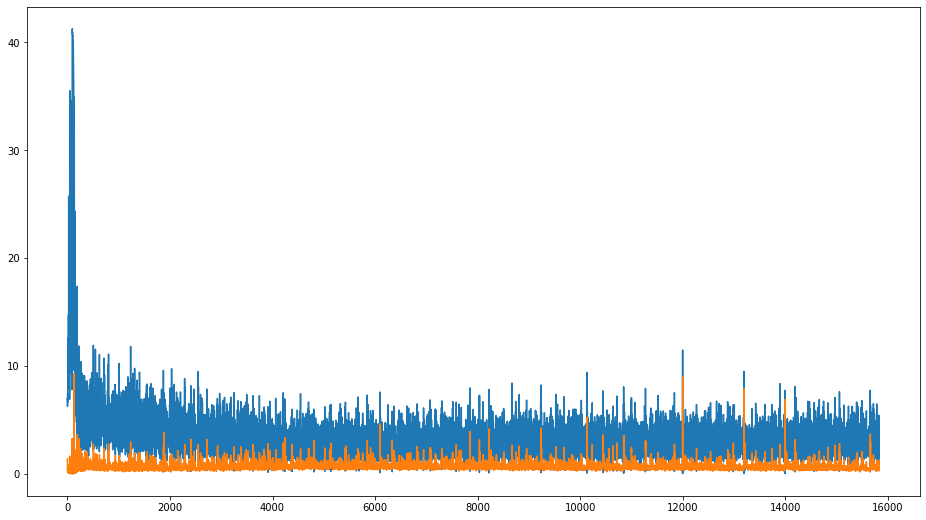

In [5]:
plt.figure(figsize=(16, 9))
plt.plot(G_losses, label="G")
plt.plot(D_losses, label="D")
plt.show()

## View Generated image history

In [6]:
img_list = torch.load('./output/gen_image.pth')

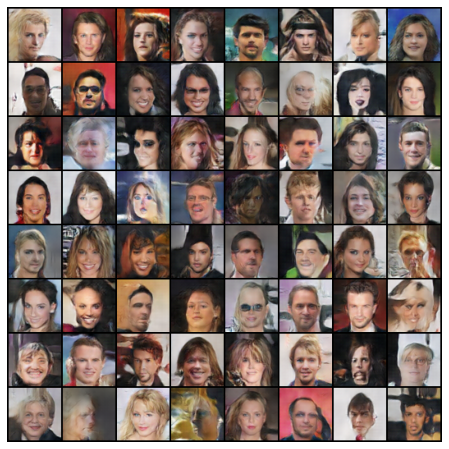

In [7]:
fig = plt.figure(figsize=(8, 8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i, (1, 2, 0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

# Generate SingleModel

In [8]:
import argparse
import os
import sys
import random

import h5py
import icecream as ic
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.backends.cudnn as cudnn
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import numpy as np

In [9]:
from main import Generator, Discriminator

Random Seed:  999


In [10]:
device = torch.device("cuda:0" if (torch.cuda.is_available() and 1 > 0) else "cpu")

In [11]:
netG = Generator(1)
netD = Discriminator(1)

netG.load_state_dict(torch.load('./Generator.pth'))
netG.eval()

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh()
  )
)

### Generate Image

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


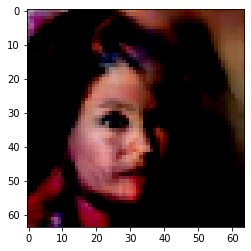

In [15]:
noise = torch.randn(1, 100, 1, 1, device="cpu")

fake = netG(noise).detach().cpu()

plt.imshow(np.transpose(fake[0],(1, 2, 0)))